In [8]:
import numpy as np
import pandas as pd

from pathlib import Path

import matplotlib.pyplot as plt
import seaborn as sns
sns.set();

path = Path.cwd().parent.parent.joinpath('results').joinpath('all_results.csv')

In [9]:
results_df = pd.read_csv(path)
results_df.head()

,optim_alg,run,pso_steps,pso_n_particles,pso_iter_n,gen_pop_size,gen_mutation_rate,gen_selection_rate,gen_selection_strategy,field_x,field_y,n_bots,trail_decay,p_resource,resource_dist_mean,resource_dist_std,p_leave,p_follow,cost,is_selected
0,pso,2,5000.0,10.0,20.0,NaN,NaN,NaN,NaN,100,100,10,100,0.01,10,3,0.452631,0.273623,283,NaN
1,pso,2,5000.0,10.0,20.0,NaN,NaN,NaN,NaN,100,100,10,100,0.01,10,3,0.127068,0.728604,130,NaN
2,pso,2,5000.0,10.0,20.0,NaN,NaN,NaN,NaN,100,100,10,100,0.01,10,3,0.960978,0.363459,258,NaN
3,pso,2,5000.0,10.0,20.0,NaN,NaN,NaN,NaN,100,100,10,100,0.01,10,3,0.842896,0.280287,275,NaN
4,pso,2,5000.0,10.0,20.0,NaN,NaN,NaN,NaN,100,100,10,100,0.01,10,3,0.682329,0.930724,306,NaN


In [10]:
#results_df['run'].unique()
results_df.shape

(573889, 20)

## Transformations

In [11]:
results_df[results_df['p_leave'] > 1] = 1
results_df[results_df['p_follow'] > 1] = 1

results_df[results_df['p_leave'] < 0] = 0
results_df[results_df['p_follow'] < 0] = 0

results_df['r_p_follow'] = results_df['p_follow'].apply(lambda x : np.round(x, 2))
results_df['r_p_leave'] = results_df['p_leave'].apply(lambda x : np.round(x, 2))

#gen_results_df = results_df[results_df['optim_alg'] == 'gen']

In [12]:
results_df.describe()

,run,pso_steps,pso_n_particles,pso_iter_n,gen_pop_size,gen_mutation_rate,gen_selection_rate,field_x,field_y,n_bots,trail_decay,p_resource,resource_dist_mean,resource_dist_std,p_leave,p_follow,cost,is_selected,r_p_follow,r_p_leave
count,5.738890e+05,221510.000000,221510.000000,221510.000000,540347.000000,540347.000000,540347.000000,573889.000000,573889.000000,573889.000000,573889.000000,573889.000000,573889.000000,573889.000000,573889.000000,573889.000000,573889.000000,239925.000000,573889.000000,573889.000000
mean,1.360118e+08,757.966616,2.831949,3.873527,16.291975,0.411630,0.411630,67.572797,67.572797,7.269448,67.572797,0.466457,6.153434,2.044435,0.839900,0.817782,503.711897,0.996736,0.817833,0.839897
std,3.409585e+08,1791.956982,4.528727,6.812545,11.322105,0.428368,0.428368,46.464070,46.464070,5.416793,46.464070,0.424630,4.453841,1.140725,0.218234,0.211986,590.984507,0.057034,0.212021,0.218262
min,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000e+00,1.000000,1.000000,1.000000,1.000000,0.100000,0.100000,1.000000,1.000000,1.000000,1.000000,0.060000,1.000000,1.000000,0.754306,0.715337,1.000000,1.000000,0.720000,0.750000
50%,1.001000e+03,1.000000,1.000000,1.000000,25.000000,0.100000,0.100000,100.000000,100.000000,10.000000,100.000000,0.300000,10.000000,3.000000,0.932807,0.878816,304.000000,1.000000,0.880000,0.930000
75%,6.666670e+05,1.000000,1.000000,1.000000,25.000000,1.000000,1.000000,100.000000,100.000000,10.000000,100.000000,1.000000,10.000000,3.000000,1.000000,1.000000,807.000000,1.000000,1.000000,1.000000
max,9.919920e+08,5000.000000,20.000000,20.000000,25.000000,1.000000,1.000000,100.000000,100.000000,20.000000,100.000000,1.000000,10.000000,3.000000,1.000000,1.000000,2768.000000,1.000000,1.000000,1.000000


## Separating results to different dfs and see amount of runs

In [13]:
# getting the pacthed results
patched_runs_df = results_df[results_df['run'] == 666667]

# getting different bot numbers
different_bot_df = results_df[results_df['run'] == 991991991]

# extracting uniform scarce df
uniform_scarce_runs_df = results_df[results_df['resource_dist_mean'] == 1]
uniform_scarce_runs_df = uniform_scarce_runs_df[uniform_scarce_runs_df['resource_dist_std'] == 0]

non_patched_runs_df = results_df[results_df['run'] != 666667]
uniform_basic_runs_df = non_patched_runs_df[non_patched_runs_df['resource_dist_mean'] == 10]
uniform_basic_runs_df = uniform_basic_runs_df[uniform_basic_runs_df['resource_dist_std'] == 3]
uniform_basic_runs_df = uniform_basic_runs_df[uniform_basic_runs_df['n_bots'] == 10]

uniform_long_runs_df = uniform_basic_runs_df[uniform_basic_runs_df['run'] == 1234568]

uniform_basic_runs_df = uniform_basic_runs_df[uniform_basic_runs_df['run'] != 1234568]
#uniform_scarce_runs_df = non_patched_runs_df[non_patched_runs_df['run'] == 84322]


In [14]:
#uniform_scarce_runs_df.head()

In [15]:
print(patched_runs_df.shape)
print(uniform_basic_runs_df.shape)
print(uniform_scarce_runs_df.shape)
print(uniform_long_runs_df.shape)
print(different_bot_df.shape)

(51956, 22)
(147665, 22)
(57223, 22)
(50491, 22)
(78586, 22)


In [16]:
#uniform_scarce_runs_df.groupby(['p_resource']).count()

In [17]:
#patched_runs_df.groupby(['p_resource']).count()

In [18]:
#uniform_long_runs_df.groupby(['p_resource']).count()

In [19]:
#uniform_basic_runs_df.groupby(['p_resource']).count()

In [20]:
different_bot_df.groupby(['p_resource', 'n_bots']).count()

less_bots_df = different_bot_df[different_bot_df['n_bots'] == 3]
more_bots_df = different_bot_df[different_bot_df['n_bots'] == 20]

less_bots_df.groupby(['p_resource', 'n_bots']).count()

,,optim_alg,run,pso_steps,pso_n_particles,pso_iter_n,gen_pop_size,gen_mutation_rate,gen_selection_rate,gen_selection_strategy,field_x,field_y,trail_decay,resource_dist_mean,resource_dist_std,p_leave,p_follow,cost,is_selected,r_p_follow,r_p_leave
p_resource,n_bots,,,,,,,,,,,,,,,,,,,,
0.01,3,3829,3829,0,0,0,3829,3829,3829,3829,3829,3829,3829,3829,3829,3829,3829,3829,0,3829,3829
0.03,3,4205,4205,0,0,0,4205,4205,4205,4205,4205,4205,4205,4205,4205,4205,4205,4205,0,4205,4205
0.05,3,3103,3103,0,0,0,3103,3103,3103,3103,3103,3103,3103,3103,3103,3103,3103,3103,0,3103,3103
0.07,3,3286,3286,0,0,0,3286,3286,3286,3286,3286,3286,3286,3286,3286,3286,3286,3286,0,3286,3286
0.09,3,3072,3072,0,0,0,3072,3072,3072,3072,3072,3072,3072,3072,3072,3072,3072,3072,0,3072,3072
0.10,3,6439,6439,0,0,0,6439,6439,6439,6439,6439,6439,6439,6439,6439,6439,6439,6439,0,6439,6439
0.30,3,4794,4794,0,0,0,4794,4794,4794,4794,4794,4794,4794,4794,4794,4794,4794,4794,0,4794,4794
0.50,3,6023,6023,0,0,0,6023,6023,6023,6023,6023,6023,6023,6023,6023,6023,6023,6023,0,6023,6023
0.70,3,4096,4096,0,0,0,4096,4096,4096,4096,4096,4096,4096,4096,4096,4096,4096,4096,0,4096,4096


In [21]:
#more_bots_df.groupby(['p_resource', 'n_bots']).count()

## Plotting 

In [22]:
# paths for plots
basic_path = Path.cwd().parent.parent.joinpath('plots').joinpath('basic')
long_path = Path.cwd().parent.parent.joinpath('plots').joinpath('long_runs')
patchy_path = Path.cwd().parent.parent.joinpath('plots').joinpath('patchy_results')
scarce_path = Path.cwd().parent.parent.joinpath('plots').joinpath('scarce_results')
diff_bots_path = Path.cwd().parent.parent.joinpath('plots').joinpath('diff_bots')
tendencies_path = Path.cwd().parent.parent.joinpath('plots').joinpath('tendencies')

In [52]:
def plot_top_runs(df, color, path, p_res):
    print(df.shape)
    limit = df['cost'].quantile(0.9)
    df['top'] = df['cost'].apply(lambda x: 1 if x > limit else 0)
    top_df = df[df['top'] == 1]
    top_df = top_df[['p_leave', 'p_follow', 'cost']]
    #sns.scatterplot(data = top_df, x = 'p_leave', y = 'p_follow', hue = 'cost')
    plot = sns.jointplot(data = top_df, x = 'p_leave', y = 'p_follow', xlim = (0,1), ylim = (0,1), kind = 'kde', color = color, bandwidth = 1.5)
    plot.fig.suptitle(f'p_resource = {str(p_res)}')
    plot.fig.subplots_adjust(top=0.95)
    plot.savefig(path)

    #sns.kdeplot(data = top_df, x = 'p_leave', y = 'p_follow')


In [53]:
df_list = [uniform_basic_runs_df, patched_runs_df, uniform_scarce_runs_df, uniform_long_runs_df, less_bots_df, more_bots_df]
parent_path_list = [basic_path, patchy_path, scarce_path, long_path, diff_bots_path, diff_bots_path]
path_starter_list = ['z', 'x', 'q', 'y', 'c', 'v']
res_options = [0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]
colors = ['salmon', 'seagreen', 'navy', 'darkorange', 'magenta', 'olive']

plot_top_runs(uniform_scarce_runs_df[uniform_scarce_runs_df['p_resource'] == 0.7], color = 'navy', path = scarce_path / 'q07.png', p_res=0.7)

(2852, 22)


RuntimeError: Selected KDE bandwidth is 0. Cannot estiamte density.

In [25]:
from typing import Tuple

In [54]:
def calc_stats(df: pd.DataFrame) -> Tuple[int, int, int]:
    #print(df.shape)
    limit = df['cost'].quantile(0.9)
    df['top'] = df['cost'].apply(lambda x: 1 if x > limit else 0)
    top_df = df[df['top'] == 1]
    top_df = top_df[['p_leave', 'p_follow', 'cost']]
    return top_df.mean(axis = 0)['p_leave'], top_df.mean(axis = 0)['p_follow'], top_df.mean(axis = 0)['cost']

In [55]:
costs, p_leaves, p_follows, p_resses, names = [], [], [], [], []

(3579, 22)
(3390, 22)
(3218, 22)
(5202, 22)
(3325, 22)
(2936, 22)
(5683, 22)
(3887, 22)
(2905, 22)
(4227, 22)
(4577, 22)
(4139, 22)
(3887, 22)
(5454, 22)
(6530, 22)
(3496, 22)
(3667, 22)
(2580, 22)
(3015, 22)
(3561, 22)
(3512, 22)
(2233, 22)
(2676, 22)
(3652, 22)
(5065, 22)
(3391, 22)
(2765, 22)
(2884, 22)
(2414, 22)
(2660, 22)
(2818, 22)
(3226, 22)
(2837, 22)
(2667, 22)
(3074, 22)
(3388, 22)
(3171, 22)
(4512, 22)
(2697, 22)
(3534, 22)
(2573, 22)
(5115, 22)
(3851, 22)
(5111, 22)
(2736, 22)
(3495, 22)
(3066, 22)
(3131, 22)
(2611, 22)
(2852, 22)
that one did not happen
(2306, 22)
(2224, 22)
(2371, 22)
(3528, 22)
(2330, 22)
(2281, 22)
(2779, 22)
(2709, 22)
(2721, 22)
(3726, 22)
(2548, 22)
(2359, 22)
(3357, 22)
(3443, 22)
(6877, 22)
(0, 22)
(3512, 22)
(3726, 22)
(3829, 22)
(0, 22)
(4205, 22)
(0, 22)
(3103, 22)
(0, 22)
(3286, 22)
(0, 22)
(3072, 22)
(6439, 22)
(0, 22)
(4794, 22)
(0, 22)
(6023, 22)
(0, 22)
(4096, 22)
(0, 22)
(3735, 22)
(0, 22)
(5030, 22)
(0, 22)
(4524, 22)
(0, 22)
(3350, 22)


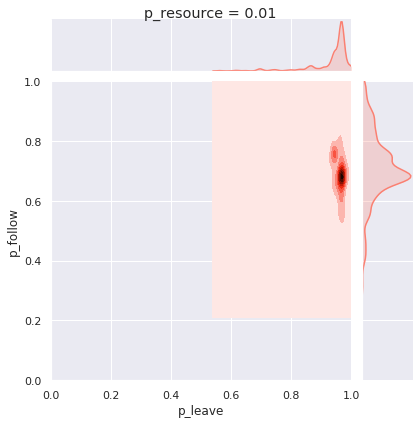

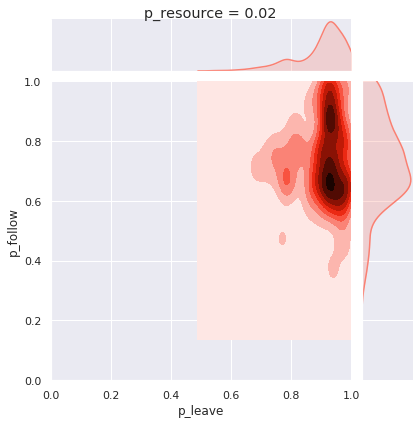

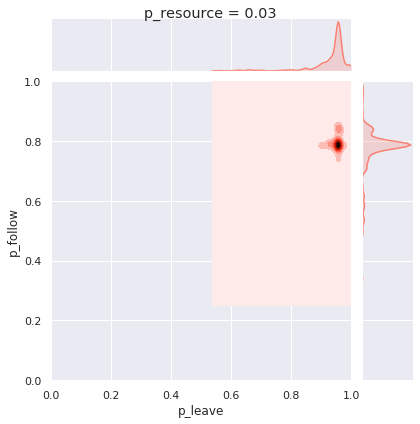

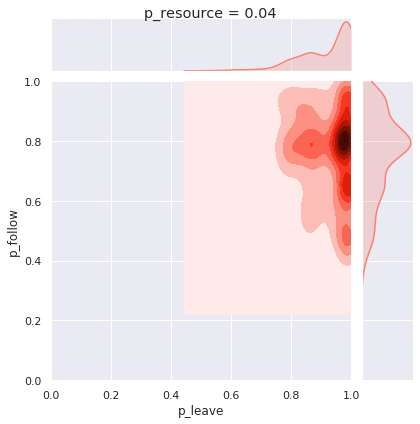

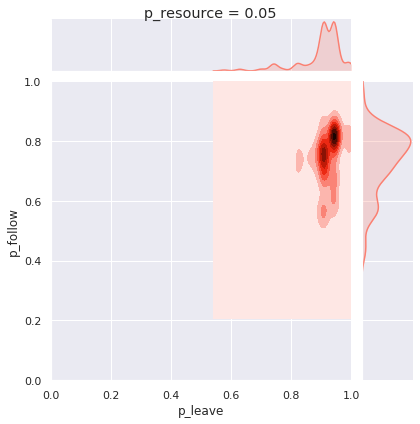

...

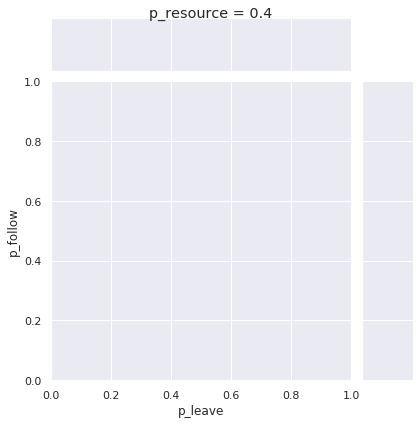

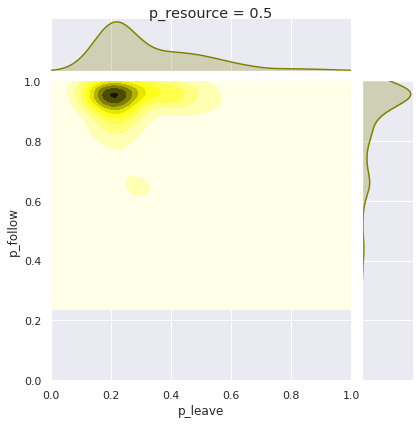

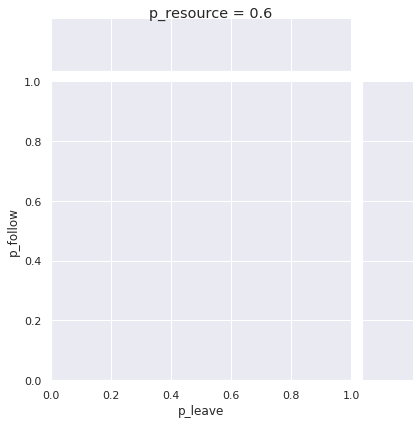

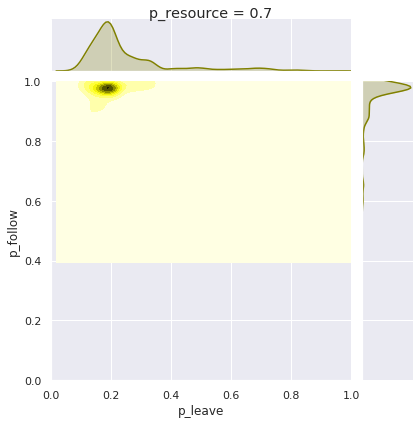

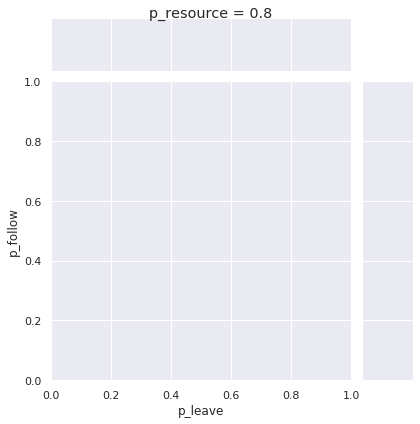

In [58]:
for df, par, child, color in zip(df_list, parent_path_list, path_starter_list, colors):
    for res in res_options:
        respath = child + str(res).replace('.', '') + '.png'
        try:
            p_leave, p_follow, cost = calc_stats(df[df['p_resource'] == res])
            
            costs.append(cost)
            p_leaves.append(p_leave)
            p_follows.append(p_follow)
            p_resses.append(res)
            names.append(child)
            
            plot_top_runs(df[df['p_resource'] == res], color=color, path=par / respath, p_res=res)
        except:
            print('that one did not happen')

In [29]:
summary_df = pd.DataFrame({'type': names, 'p_resource': p_resses, 'mean_p_leave': p_leaves, 'mean_p_follow': p_follows, 'mean_fitness': costs})
summary_df.head()

,type,p_resource,mean_p_leave,mean_p_follow,mean_fitness
0,z,0.01,0.934295,0.710206,379.866097
1,z,0.02,0.899051,0.729831,534.310241
2,z,0.03,0.930728,0.759914,641.797508
3,z,0.04,0.918701,0.748904,717.547244
4,z,0.05,0.900005,0.728579,773.712121


## Probe plots

In [30]:
#plot_top_runs(uniform_basic_runs_df[uniform_basic_runs_df['p_resource'] == 0.01], 'salmon', basic_path / 'z001.png')

In [31]:
#plot_top_runs(uniform_long_runs_df[uniform_long_runs_df['p_resource'] == 0.01], 'darkorange', long_path / 'y001.png')

In [32]:
#plot_top_runs(different_bot_df[different_bot_df['p_resource'] == 0.01], 'magenta', diff_bots_path / 'w001.png')

## Tendency plots 

In [33]:
df_dict = {'z': 'Uniform basic', 'x': 'Patched resources', 'q': 'Uniform Scarce', 'y': 'Uniform long', 'c': 'Less bots', 'v': 'More bots'}

In [34]:
summary_df['type'] = summary_df['type'].apply(lambda x: df_dict[x])
summary_df.head(3)

,type,p_resource,mean_p_leave,mean_p_follow,mean_fitness
0,Uniform basic,0.01,0.934295,0.710206,379.866097
1,Uniform basic,0.02,0.899051,0.729831,534.310241
2,Uniform basic,0.03,0.930728,0.759914,641.797508


In [35]:
def plot_tendencies(type):
    this_df = summary_df[summary_df['type'] == type]
    this_df = this_df[this_df['mean_cost'] != 0]
    
    cost_plot = sns.lineplot(x='p_resource', y='mean_cost', color='magenta', data = this_df)
    #cost_plot.fig.suptitle(f'Cost for {type}')
    #cost_plot.fig.subplots_adjust(top=0.95)
    cost_plot.figure.savefig(tendencies_path / 'try.png')

In [36]:
def plot_boxes(df, color, runcode):
    selected_df = df[['p_resource', 'p_leave', 'p_follow', 'cost']]
    grouped_df = selected_df[['p_resource', 'cost']].groupby('p_resource').quantile(0.9)
    selected_df['limit'] = selected_df['p_resource'].apply(lambda x: grouped_df.loc[x, 'cost'])
    top_df = selected_df.query('cost > limit')

    top_df['fitness'] = top_df['cost']

    valid_res = set(res_options)
    top_df['res_filter'] = top_df['p_resource'].apply(lambda x: 1 if x in valid_res else 0)
    top_df = top_df.query('res_filter == 1')

    # plot cost tendency
    fig, ax = plt.subplots()
    fig.set_size_inches(14,8)
    a = sns.lineplot(x = 'p_resource', y = 'fitness', data = top_df, ax=ax, color=color, linewidth = 3)
    a = sns.scatterplot(x = 'p_resource', y = 'fitness', data = top_df, alpha = 0.5, ax=ax, color=color)
    #a = sns.swarmplot(x = 'p_resource', y = 'cost', data = top_df, ax=ax, color=color)
    mypath = f"{df_dict[runcode]}_fitness.png"
    print(mypath)
    a.figure.savefig(tendencies_path / mypath)

    # plot cost tendency
    fig, ax = plt.subplots()
    fig.set_size_inches(14,8)
    a = sns.regplot(x = 'p_resource', y = 'fitness', data = top_df, ax=ax, color=color)
    #a = sns.swarmplot(x = 'p_resource', y = 'cost', data = top_df, ax=ax, color=color)
    mypath = f"{df_dict[runcode]}_fitness_reg.png"
    print(mypath)
    a.figure.savefig(tendencies_path / mypath)

    # plot p_follow tendency
    fig, ax = plt.subplots()
    fig.set_size_inches(14,8)
    a = sns.boxplot(x = 'p_resource', y = 'p_follow', data = top_df, ax=ax, color=color)
    mypath = f"{df_dict[runcode]}_follow.png"
    print(mypath)
    a.figure.savefig(tendencies_path / mypath)

    # plot p_leave tendency
    fig, ax = plt.subplots()
    fig.set_size_inches(14,8)
    a = sns.boxplot(x = 'p_resource', y = 'p_leave', data = top_df, ax=ax, color=color)
    mypath = f"{df_dict[runcode]}_leave.png"
    a.figure.savefig(tendencies_path / mypath)

Uniform basic_fitness.png
Uniform basic_fitness_reg.png
Uniform basic_follow.png
Patched resources_fitness.png
Patched resources_fitness_reg.png
Patched resources_follow.png
Uniform Scarce_fitness.png
Uniform Scarce_fitness_reg.png
Uniform Scarce_follow.png
Uniform long_fitness.png
Uniform long_fitness_reg.png
Uniform long_follow.png
Less bots_fitness.png
Less bots_fitness_reg.png
Less bots_follow.png
More bots_fitness.png
More bots_fitness_reg.png
More bots_follow.png


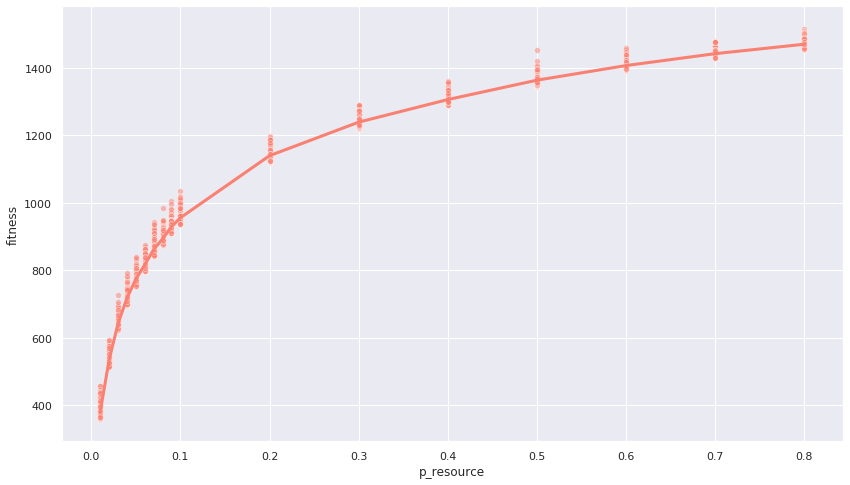

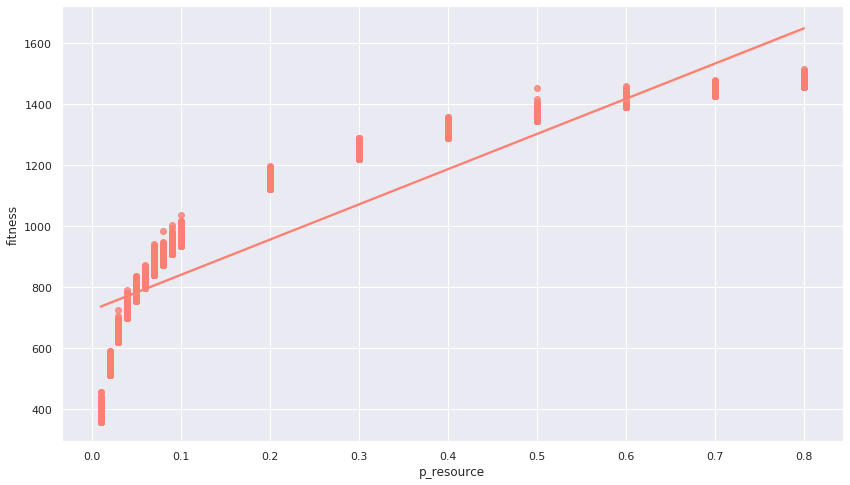

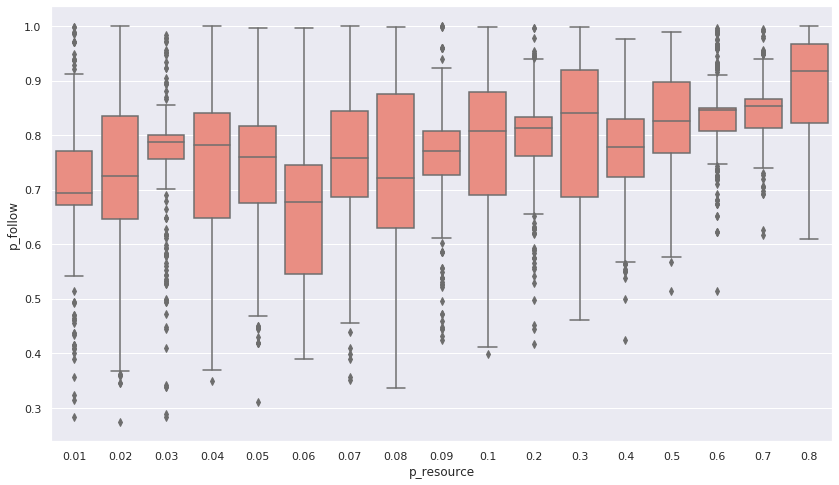

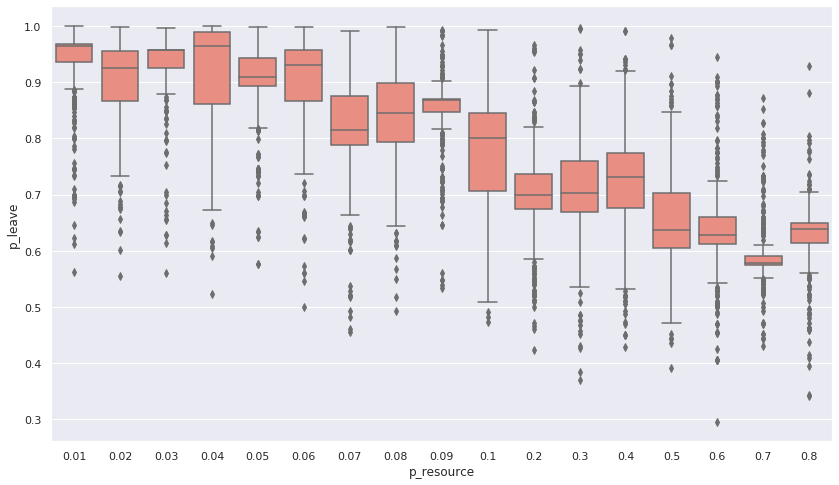

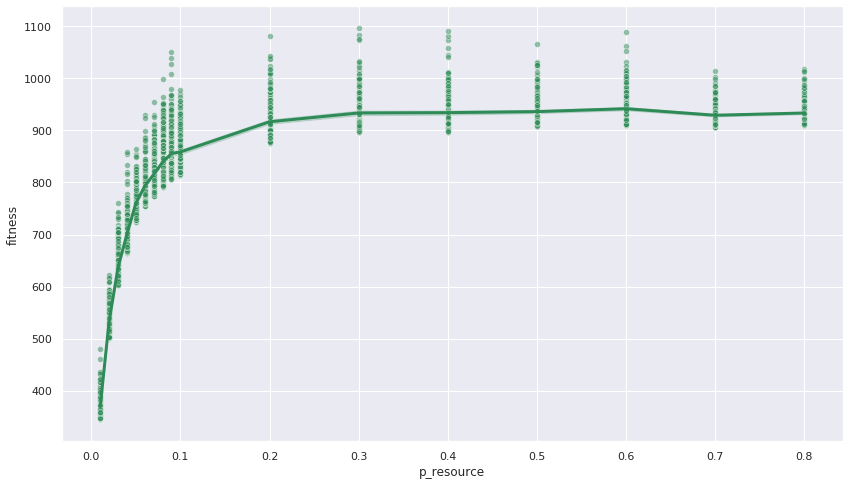

...

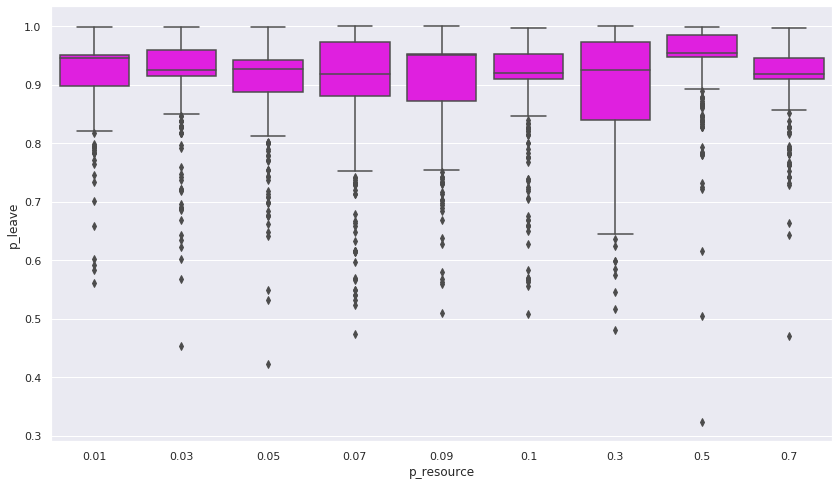

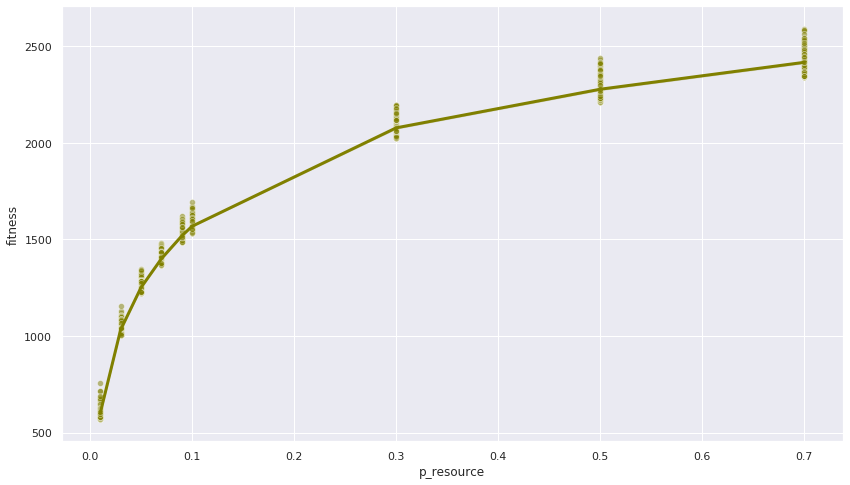

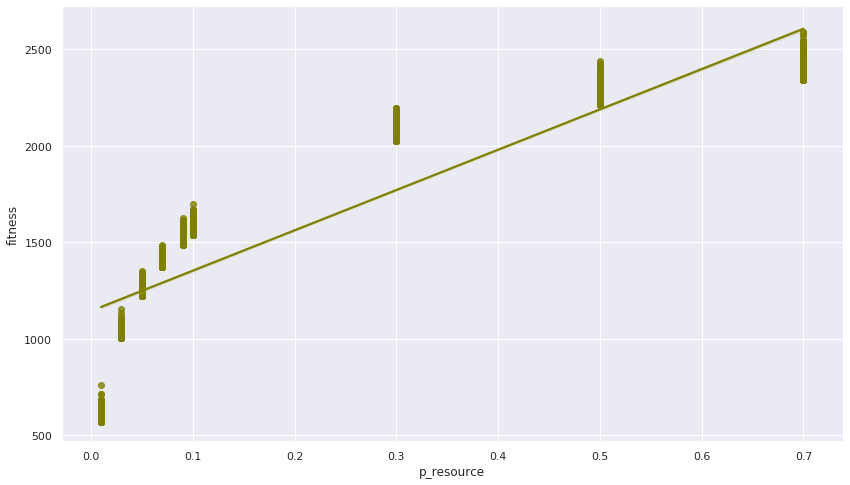

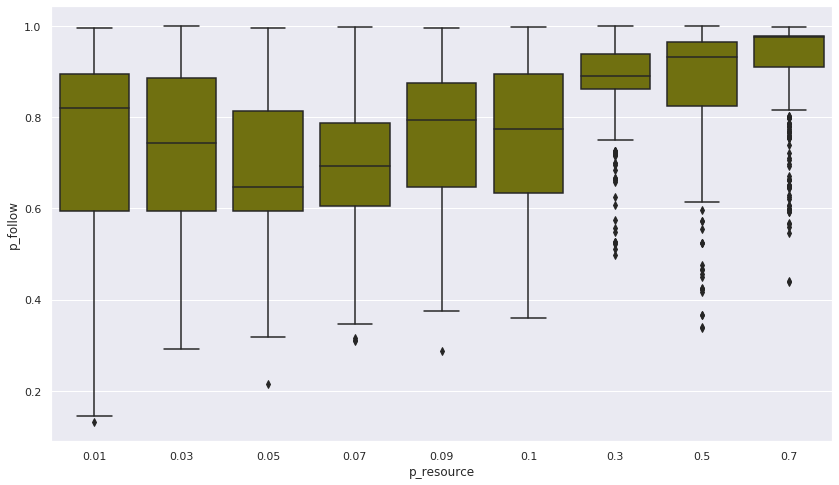

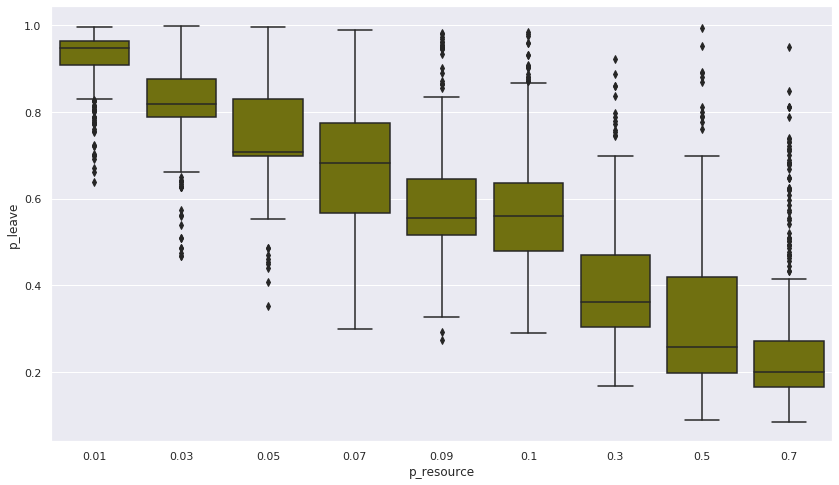

In [37]:
for df, child, color in zip(df_list, path_starter_list, colors):
    plot_boxes(df, color, child)

In [38]:
uniform_selected_df = uniform_basic_runs_df[['p_resource', 'p_leave', 'p_follow', 'cost']]
uniform_grouped = uniform_selected_df[['p_resource', 'cost']].groupby('p_resource').quantile(0.9)
uniform_grouped.loc[0.001, 'cost']

uniform_selected_df['limit'] = uniform_selected_df['p_resource'].apply(lambda x: uniform_grouped.loc[x, 'cost'])
top_df = uniform_selected_df.query('cost > limit')

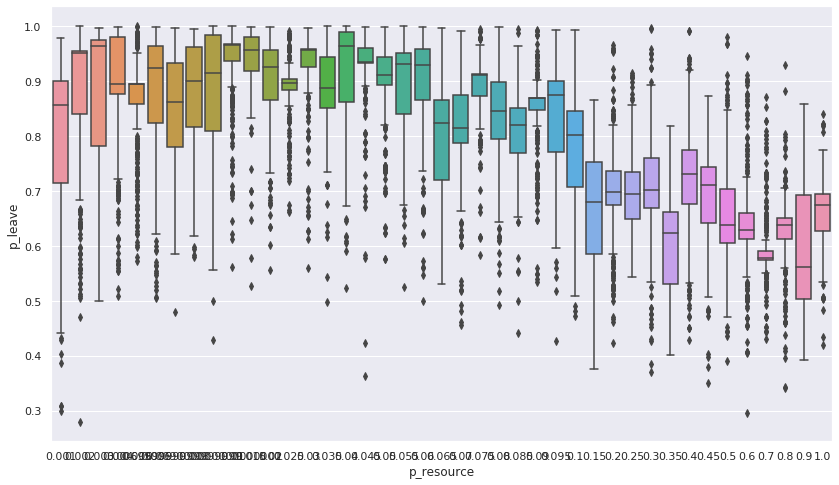

In [39]:
fig, ax = plt.subplots()
fig.set_size_inches(14,8)
a = sns.boxplot(x = 'p_resource', y = 'p_leave', data = top_df, ax=ax)
a.figure.savefig('a.png')

In [40]:
#plot_tendencies('Uniform basic')

In [41]:
#plot_tendencies('Patched resources')

In [42]:
def get_top_runs(df, path):
    selected_df = df[['p_resource', 'p_leave', 'p_follow', 'cost']]
    grouped_df = selected_df[['p_resource', 'cost']].groupby('p_resource').quantile(0.9)
    selected_df['limit'] = selected_df['p_resource'].apply(lambda x: grouped_df.loc[x, 'cost'])
    top_df = selected_df.query('cost > limit')

    top_df['fitness'] = top_df['cost']
    top_df['type'] = df_dict[path]

    valid_res = set(res_options)
    top_df['res_filter'] = top_df['p_resource'].apply(lambda x: 1 if x in valid_res else 0)
    top_df = top_df.query('res_filter == 1')

    return top_df

In [43]:
top_dfs = [get_top_runs(df, k) for df, k in zip(df_list, path_starter_list)]

In [44]:
for df in top_dfs:
    print(df.iloc[0]['type'])

Uniform basic
Patched resources
Uniform Scarce
Uniform long
Less bots
More bots


## Plotting fitness for uniform vs patchy

uni_patchy_scarce_fitness.png


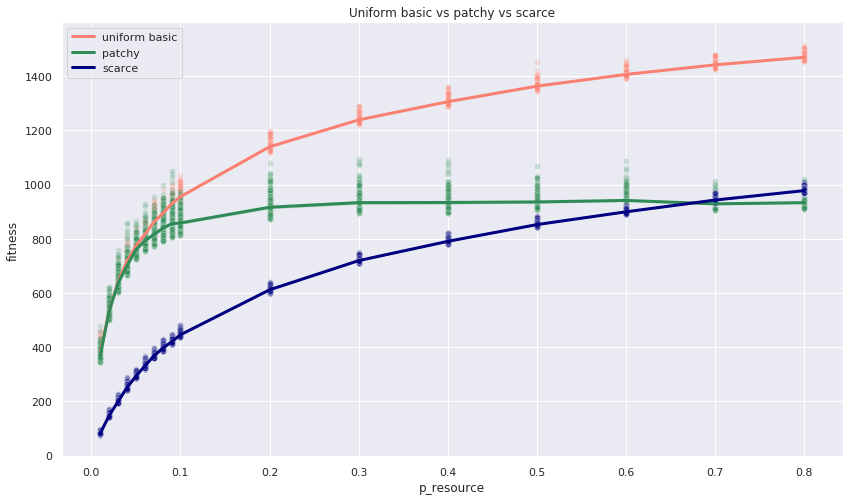

In [45]:
fig, ax = plt.subplots()
fig.set_size_inches(14,8)
#a = sns.lineplot(x = 'p_resource', y = 'fitness', data = uni_patchy_df, hue = 'type', ax=ax, alpha = 0.5, palette = color, linewidth = 3)
a = sns.lineplot(x = "p_resource", y = 'fitness', data = top_dfs[0], ax = ax, color = colors[0], lw = 3, label = 'uniform basic')
a = sns.lineplot(x = "p_resource", y = 'fitness', data = top_dfs[1], ax = ax, color = colors[1], lw = 3, label = 'patchy')
a = sns.lineplot(x = "p_resource", y = 'fitness', data = top_dfs[2], ax = ax, color = colors[2], lw = 3, label = 'scarce')
#a = sns.lineplot(x = "p_resource", y = 'fitness', data = top_dfs[3], ax = ax, color = colors[3], lw = 3, label = 'long')
#a = sns.lineplot(x = "p_resource", y = 'fitness', data = top_dfs[4], ax = ax, color = colors[4], lw = 3, label = 'less bots')
#a = sns.lineplot(x = "p_resource", y = 'fitness', data = top_dfs[5], ax = ax, color = colors[5], lw = 3, label = 'more bots')

a = sns.scatterplot(x = "p_resource", y = 'fitness', data = top_dfs[0], ax = ax, color = colors[0], alpha = 0.2)
a = sns.scatterplot(x = "p_resource", y = 'fitness', data = top_dfs[1], ax = ax, color = colors[1], alpha = 0.2)
a = sns.scatterplot(x = "p_resource", y = 'fitness', data = top_dfs[2], ax = ax, color = colors[2], alpha = 0.2)
#a = sns.scatterplot(x = "p_resource", y = 'fitness', data = top_dfs[3], ax = ax, color = colors[3], alpha = 0.2)
#a = sns.scatterplot(x = "p_resource", y = 'fitness', data = top_dfs[4], ax = ax, color = colors[4], alpha = 0.2)
#a = sns.scatterplot(x = "p_resource", y = 'fitness', data = top_dfs[5], ax = ax, color = colors[5], alpha = 0.2)

a.legend()
a.set_title('Uniform basic vs patchy vs scarce')
mypath = "uni_patchy_scarce_fitness.png"
print(mypath)
a.figure.savefig(tendencies_path / mypath)
